<a href="https://colab.research.google.com/github/anshupandey/MA_AI900/blob/main/Lab6_GenerativeAI_for_NLP_Vision_tasks.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# LLM‑powered NLP & Vision (Azure OpenAI — GPT‑4.1 mini)
**Version:** 2025-09-19 03:27:40


## 0) Setup — Azure OpenAI client
Set env vars `AZURE_OPENAI_API_KEY`, `AZURE_OPENAI_ENDPOINT`, `AZURE_OPENAI_DEPLOYMENT=gpt-4.1-mini`, `AZURE_OPENAI_API_VERSION=2024-06-01`.


In [ ]:
!pip -q install -U openai pillow

In [28]:
import os, base64, json, io
from typing import Optional, Dict, Any, List
from PIL import Image
from openai import AzureOpenAI
from IPython.display import display
import os
os.environ['AZURE_OPENAI_ENDPOINT'] = "https://xxxx.openai.azure.com/"
os.environ['AZURE_OPENAI_API_KEY'] = ""
os.environ['OPENAI_API_VERSION'] = "2025-03-01-preview"


client = AzureOpenAI()

def _messages(user_text: str, system_text: Optional[str] = None, image_b64: Optional[str] = None):
    content = []
    if user_text:
        content.append({"type": "text", "text": user_text})
    if image_b64:
        content.append({"type":"image_url","image_url":{"url": f"data:image/png;base64,{image_b64}"}})
    msgs = []
    if system_text:
        msgs.append({"role": "system", "content": system_text})
    msgs.append({"role":"user","content": content if image_b64 else user_text})
    return msgs

def call_text(prompt: str, system: Optional[str] = None, temperature: float = 0.2, max_tokens: int = 700, json_mode: bool = False):
    kwargs = {}
    if json_mode:
        kwargs["response_format"] = {"type": "json_object"}
    r = client.chat.completions.create(
        model='gpt-4.1-mini',
        messages=_messages(prompt, system_text=system),
        temperature=temperature,
        max_tokens=max_tokens,
        **kwargs
    )
    return r.choices[0].message.content

def call_json(prompt: str, system: Optional[str] = None, temperature: float = 0.2, max_tokens: int = 900):
    out = call_text(prompt, system=system, temperature=temperature, max_tokens=max_tokens, json_mode=True)
    try:
        return json.loads(out)
    except Exception:
        start, end = out.find("{"), out.rfind("}")
        if start >= 0 and end > start:
            return json.loads(out[start:end+1])
        raise

def image_to_b64(path: str) -> str:
    with Image.open(path) as im:
        buf = io.BytesIO()
        im.convert("RGB").save(buf, format="PNG")
    return base64.b64encode(buf.getvalue()).decode("utf-8")

def call_vision(image_path: str, user_prompt: str, system: Optional[str] = None, temperature: float = 0.2, max_tokens: int = 900, json_mode: bool = False):
    b64 = image_to_b64(image_path)
    kwargs = {}
    if json_mode:
        kwargs["response_format"] = {"type": "json_object"}
    r = client.chat.completions.create(
        model='gpt-4.1-mini',
        messages=_messages(user_prompt, system_text=system, image_b64=b64),
        temperature=temperature,
        max_tokens=max_tokens,
        **kwargs
    )
    return r.choices[0].message.content

def display_image(image_path):
    """Loads and displays an image using Pillow."""
    try:
        with Image.open(image_path) as img:
            display(img)
    except FileNotFoundError:
        print(f"Error: Image file not found at {image_path}")
    except Exception as e:
        print(f"An error occurred: {e}")


## Part 1 — Prompts as “Model Replacement” for NLP
Below are **10** text scenarios (more will follow) aligned to assurance/tax/consulting.


### 01) Zero-shot expense category classification
**Why:** Low‑lift labeling without training.


In [5]:
resp = call_json('''Classify the text into one or more categories from ONLY this set:
["Office Supplies","Travel","Meals & Entertainment","Consulting","Revenue Adjustment"]

Return STRICT JSON {"labels":[string], "rationale": "short"}.
If unsure, return [] and rationale "Insufficient information."

Text:
"Taxi from airport to client office; dinner with client; notebook purchase."''')
print(resp)

{'labels': ['Travel', 'Meals & Entertainment', 'Office Supplies'], 'rationale': 'Taxi is travel, dinner is meals & entertainment, notebook is office supplies.'}


### 02) Few-shot control frequency normalization
**Why:** Real phrasing varies; few‑shot reduces variance.


In [6]:
fewshot = '''
You normalize frequency to one of: ["Daily","Weekly","Monthly","Quarterly","Annual","Ad-Hoc"].
Output STRICT JSON: {"normalized_frequency": string, "rationale": "short"}.

Examples:
Text: "Performed each business day by the AR clerk."
JSON: {"normalized_frequency":"Daily","rationale":"each business day"}

Text: "Control is reviewed every Monday."
JSON: {"normalized_frequency":"Weekly","rationale":"every Monday"}

Text: "At month-end close, manager performs reconciliation."
JSON: {"normalized_frequency":"Monthly","rationale":"month-end close"}

Now normalize:
Text: "Reviewed on the last Friday of every month."
JSON:
'''
print(call_text(fewshot))

{"normalized_frequency":"Monthly","rationale":"last Friday of every month"}


### 03) Policy → structured JSON fields
**Why:** Replace custom NER by extracting key fields.


In [7]:
resp = call_json('''Extract STRICT JSON fields from the policy below:
- recognition_basis: one of ["Delivery","Shipment","Other"] or null
- variable_consideration: boolean
- discount_documentation_required: boolean
- control_owner: string or null

Policy:
"Revenue recognized on delivery (FOB Destination). Variable consideration is estimated and constrained.
Discounts must appear on sales orders and invoices. Owner: Order Management."''')
print(resp)

{'recognition_basis': 'Delivery', 'variable_consideration': True, 'discount_documentation_required': True, 'control_owner': 'Order Management'}


### 04) PII detection & redaction suggestions
**Why:** Quick PII screening.


In [8]:
resp = call_json('''Identify PII in the text and propose redaction tokens.
Return STRICT JSON: {"pii_types":[string], "examples":[string], "redaction_guidelines":[string]}

Text:
"Contact: Jane Doe, email jane.doe@example.com, cell +1-425-555-7890, SSN 123-45-6789."''')
print(resp)

{'pii_types': ['Full Name', 'Email Address', 'Phone Number', 'Social Security Number'], 'examples': ['Jane Doe', 'jane.doe@example.com', '+1-425-555-7890', '123-45-6789'], 'redaction_guidelines': ['Replace full names with [NAME]', 'Replace email addresses with [EMAIL]', 'Replace phone numbers with [PHONE]', 'Replace Social Security Numbers with [SSN]']}


### 05) Sentiment & urgency for support email
**Why:** Triage tickets by tone and urgency.


In [9]:
resp = call_json('''Rate sentiment and urgency.
Return STRICT JSON: {"sentiment": "positive|neutral|negative", "urgency": 1-5, "rationale":"short"}

Email:
"Our ERP close failed again before quarter-end. We need a hotfix tonight."''')
print(resp)

{'sentiment': 'negative', 'urgency': 5, 'rationale': 'Critical failure requiring immediate fix before quarter-end.'}


### 06) Audience-aware summary (IT vs Executive)
**Why:** Adapt one summary for two audiences.


In [10]:
resp = call_json('''Summarize the report below for two audiences.

Return STRICT JSON:
{"it_summary": "3 bullets", "exec_summary":"<=80 words"}

Report:
"During UAT of the journal workflow, three defects were logged: approval race condition,
incorrect rounding on multi-currency journals, and timeout on bulk import over VPN."''')
print(resp)

{'it_summary': ['Logged three defects during UAT of the journal workflow.', 'Issues include approval race condition, incorrect rounding on multi-currency journals, and timeout on bulk import over VPN.', 'Defects impact workflow reliability and data accuracy.'], 'exec_summary': 'Three defects were identified during user acceptance testing of the journal workflow, including approval race conditions, rounding errors in multi-currency journals, and timeouts during bulk imports over VPN, affecting system reliability and accuracy.'}


### 07) Style transformation to audit‑neutral tone
**Why:** Standardize tone.


In [11]:
resp = call_text('''Rewrite the text in neutral auditor-style prose.
Two short paragraphs; avoid: leverage, cutting-edge, synergy.

Text:
"Our innovative tool slashed close time! It’s cutting-edge, insanely fast,
and totally synergistic with your processes."''')
print(resp)

The tool significantly reduced the time required to close processes. It operates with high speed and integrates effectively with existing workflows.


### 08) Topic tagging (top‑k)
**Why:** Lightweight replacement for topic model.


In [12]:
resp = call_json('''Select the 5 most relevant tags from this list:
["GL","Revenue","Controls","Tax","SOC","IT General Controls","Segregation of Duties","Payroll"]

Return STRICT JSON {"tags":[string]}.

Text:
"Revenue policy (ASC 606): delivery-based recognition, discount documentation,
and prior timing issues due to late shipment confirmations."''')
print(resp)

{'tags': ['Revenue', 'Controls', 'Tax', 'SOC', 'IT General Controls']}


### 09) Regex generator for invoice numbers
**Why:** Rapid ETL validator.


In [13]:
resp = call_json('''Generate a regex for invoice numbers like INV-2024-1032, INV-2023-0001.
Return STRICT JSON {"regex": "pattern", "tests_pass":[string], "tests_fail":[string]}.
''')
print(resp)

{'regex': '^INV-\\d{4}-\\d{4}$', 'tests_pass': ['INV-2024-1032', 'INV-2023-0001'], 'tests_fail': ['INV-24-1032', 'INV-2024-103', 'INV-2024-10321', 'inv-2024-1032', 'INV2024-1032', 'INV-2024-ABCD']}


### 10) Date normalization from messy inputs
**Why:** Parse to ISO dates.


In [14]:
resp = call_json('''Normalize dates from text into YYYY-MM-DD.
Return STRICT JSON {"dates":[{"raw":string,"iso":string|null}]}

Text:
"Invoice dated Sept 1st '24; payment due end of next month; shipped 28/09/24."''')
print(resp)

{'dates': [{'raw': "Sept 1st '24", 'iso': '2024-09-01'}, {'raw': '28/09/24', 'iso': '2024-09-28'}]}


### 11) Currency/amount parsing (no FX conversion)
**Why:** Extract amounts/currencies for downstream logic.


In [15]:
resp = call_json('''Extract amounts and currencies. Do not convert FX.

Return STRICT JSON {"amounts":[{"raw":string,"value":number,"currency":string|null}]}

Text:
"Total EUR 1.234,50; discount $25.00; tax GBP 10."''')
print(resp)

{'amounts': [{'raw': 'EUR 1.234,50', 'value': 1234.5, 'currency': 'EUR'}, {'raw': '$25.00', 'value': 25.0, 'currency': 'USD'}, {'raw': 'GBP 10', 'value': 10, 'currency': 'GBP'}]}


### 12) Near‑duplicate description check
**Why:** Decide if two entries are substantively similar.


In [16]:
resp = call_json('''Compare the two descriptions. Return STRICT JSON {"duplicate": true|false, "why":"<=20 words"}.

A: "Monthly reconciliation of cash subledger to GL by controller."
B: "Controller performs month-end reconciliation of cash subledger to the general ledger."''')
print(resp)

{'duplicate': True, 'why': "Both describe controller's monthly reconciliation of cash subledger to general ledger."}


### 13) Entity linking to canonical vendor list
**Why:** Resolve free‑text to master data.


In [17]:
resp = call_json('''Link the mentioned vendor to one of these canonical names:
["BRIGHTOFFICE SUPPLIES LLC","ACME CORPORATION","CONTOSO LTD"]

Return STRICT JSON {"vendor":"name|null","confidence":0-1,"why":"<=20 words"}

Text: "BrightOffice Supplies, LLC"''')
print(resp)

{'vendor': 'BRIGHTOFFICE SUPPLIES LLC', 'confidence': 1, 'why': 'Exact match ignoring punctuation and case'}


### 14) SQL skeleton for ad hoc query
**Why:** Accelerate analyst workflow; still requires review.


In [18]:
resp = call_text('''Write a SELECT skeleton for "top 10 vendors by spend" in table invoices(vendor, amount, invoice_date).
Include WHERE invoice_date in last 365 days. No DML. Add TODOs as comments.''')
print(resp)

```sql
SELECT
    vendor,
    SUM(amount) AS total_spend
FROM
    invoices
WHERE
    invoice_date >= CURRENT_DATE - INTERVAL '365 days'  -- TODO: Adjust date logic if needed for your SQL dialect
    -- TODO: Add any additional filters if required
GROUP BY
    vendor
ORDER BY
    total_spend DESC
LIMIT 10;  -- TODO: Adjust limit if needed
```


### 15) Email draft to request missing documents
**Why:** Reduce cycle time with consistent, cordial asks.


In [19]:
resp = call_text('''Draft an email requesting the PO and proof of delivery for INV-2024-1032.
Neutral tone, 120-160 words, include a 3-item checklist and a 3-day deadline.''')
print(resp)

Subject: Request for PO and Proof of Delivery for INV-2024-1032

Dear [Recipient's Name],

I hope this message finds you well. To proceed with the processing of invoice INV-2024-1032, could you please provide the following documents at your earliest convenience:

1. Purchase Order (PO) related to INV-2024-1032  
2. Proof of Delivery (POD) confirming receipt of the goods/services  
3. Any additional documentation relevant to this transaction  

Kindly send these documents within the next three business days to ensure timely processing on our end. If you require any further information or assistance, please do not hesitate to reach out.

Thank you for your prompt attention to this matter.

Best regards,  
[Your Name]  
[Your Position]  
[Your Contact Information]


### 16) Control risk scoring with rubric
**Why:** Standardize qualitative ratings.


In [20]:
resp = call_json('''Rate risk 1-5 using this rubric:
1 trivial, 3 moderate, 5 high potential misstatement.
Return STRICT JSON {"score":1-5,"reason":"<=25 words"}

Control:
"Order entry requires approval; logs reviewed weekly; evidence archived."''')
print(resp)

{'score': 2, 'reason': 'Controls reduce risk but weekly log reviews may delay error detection, posing moderate risk of misstatement.'}


### 17) Generate UAT test cases from requirement
**Why:** Fast prototyping for QA.


In [21]:
resp = call_text('''From the requirement below, write 6 UAT test cases (bulleted), each with: step, expected result.
Requirement: "Only managers can approve sales orders over $10,000; log all approvals."''')
print(resp)

- **Test Case 1: Manager approves sales order over $10,000**  
  Step: Login as a manager and approve a sales order with a total amount of $15,000.  
  Expected Result: Approval is successful, and the approval action is logged.

- **Test Case 2: Non-manager attempts to approve sales order over $10,000**  
  Step: Login as a non-manager user and attempt to approve a sales order with a total amount of $12,000.  
  Expected Result: Approval is denied with an appropriate error message; no approval is logged.

- **Test Case 3: Manager approves sales order equal to $10,000**  
  Step: Login as a manager and approve a sales order with a total amount of exactly $10,000.  
  Expected Result: Approval is successful, and the approval action is logged.

- **Test Case 4: Non-manager approves sales order under $10,000**  
  Step: Login as a non-manager user and approve a sales order with a total amount of $9,999.  
  Expected Result: Approval is successful (if allowed by other business rules), and t

### 18) Extract assumptions & open items
**Why:** Find implicit gaps before sign‑off.


In [22]:
resp = call_json('''Return STRICT JSON:
{"assumptions":[string], "open_items":[string]}

Text:
"Revenue recognized at delivery; assumes carrier scans reflect receipt within 24h; discount policy under revision."''')
print(resp)

{'assumptions': ['Revenue is recognized at the time of delivery.', 'Carrier scans accurately reflect receipt within 24 hours.'], 'open_items': ['Discount policy is currently under revision.']}


### 19) List → JSON transformation
**Why:** Normalize unstructured bulleted data.


In [23]:
resp = call_json('''Convert the bullets into STRICT JSON records with fields:
description, qty:int|null, unit_price:float|null

Bullets:
- Laser Printer Toner QTY 4 @ 79.50
- A4 Paper (10 reams) QTY 10 @ 6.25
- Office Chairs QTY 2 @ 199.00''')
print(resp)

{'items': [{'description': 'Laser Printer Toner', 'qty': 4, 'unit_price': 79.5}, {'description': 'A4 Paper (10 reams)', 'qty': 10, 'unit_price': 6.25}, {'description': 'Office Chairs', 'qty': 2, 'unit_price': 199.0}]}


### 20) Explicit 'insufficient information' policy
**Why:** Predictable outputs when data is missing.


In [24]:
resp = call_json('''Extract: customer_name, delivery_term, payment_term.
If unknown, set null and add to missing_fields.

Return STRICT JSON {"customer_name":str|null,"delivery_term":str|null,"payment_term":str|null,"missing_fields":[string]}

Text:
"PO: 7781; terms not stated; customer name: ACME Corp."''')
print(resp)

{'customer_name': 'ACME Corp.', 'delivery_term': None, 'payment_term': None, 'missing_fields': ['delivery_term', 'payment_term']}


## Part 2 — Multimodal (Vision) with GPT‑4.1 mini
Place sample images locally and set the path (e.g., `images/invoice_1.png`).


In [32]:
#!/usr/bin/env bash
# Usage: bash fetch_audit_images.sh [target_folder]
# Downloads open-licensed, domain-relevant images (invoice/receipt/PO/contract/policy/dashboard)
# and writes an ATTRIBUTIONS.md. If ImageMagick is available, also creates PNG copies.

!set -euo pipefail

!DEST="${1:-images}"
!mkdir -p "$DEST"
!cd "$DEST"

!echo "→ Downloading images into: $(pwd)"

# --- Invoice (garage service invoice) ---
!wget -q -O invoice_uk_garage.jpg \
  "https://upload.wikimedia.org/wikipedia/commons/e/eb/Invoice.jpg"

# --- Retail receipt (Target, Honolulu) ---
!wget -q -O receipt_target.jpg \
  "https://upload.wikimedia.org/wikipedia/commons/a/ad/Target_Receipt_5-12-2018.jpg"

# --- Purchase Order form (example PO request) ---
!wget -q -O purchase_order_form.jpg \
  "https://upload.wikimedia.org/wikipedia/commons/9/95/Purchase_Order_Request_Form.jpg"

# --- Contract page (sample worker contract) ---
!wget -q -O contract_worker_page1.jpg \
  "https://upload.wikimedia.org/wikipedia/commons/7/7f/Sample_UAE_alien_worker_contract-1.jpg"

# --- Policy / manual page (U.S. GPO Style Manual – public domain) ---
!wget -q -O invoice2.png \
  "https://templates.invoicehome.com/invoice-template-us-neat-750px.png"

  !wget -q -O policy.png "https://cdn.shopify.com/s/files/1/0564/9625/9172/files/Compliance_1_1024x1024.png"

# --- KPI / dashboard screenshot (Ceph dashboard UI) ---
!wget -q -O dashboard_ceph.jpg \
  "https://www.slideteam.net/media/catalog/product/cache/1280x720/i/n/internal_audit_dashboard_overview_of_internal_audit_planning_checklist_slide01.jpg"

!echo "→ Downloads complete."


mkdir: cannot create directory ‘’: No such file or directory
→ Downloading images into: /content
→ Downloads complete.


### 25) Invoice field extraction from image
**Why:** Quick prototype without OCR.


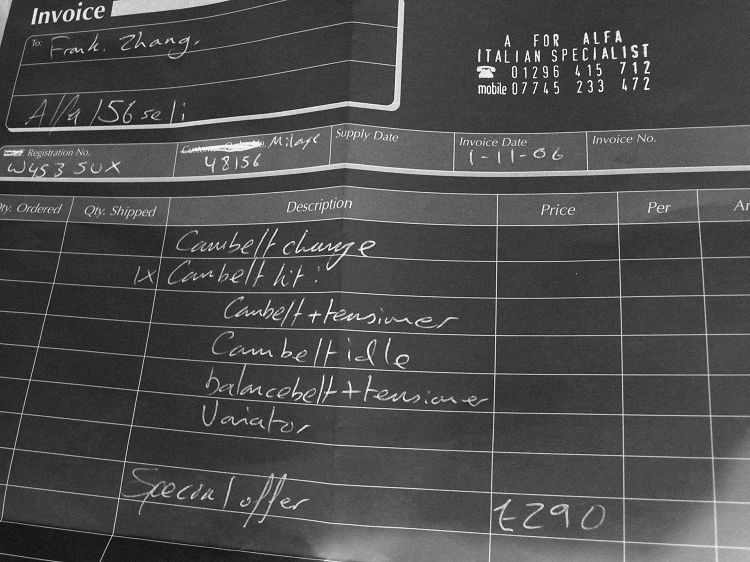

{
  "vendor": "A FOR ALFA ITALIAN SPECIALIST",
  "invoice_number": null,
  "invoice_date": "1-11-06",
  "due_date": null,
  "currency": null,
  "missing_fields": ["invoice_number", "due_date", "currency"]
}


In [29]:

image_path = "/content/invoice_uk_garage.jpg"  # <-- change to your file path
display_image(image_path)


In [30]:

resp = call_vision(
    image_path=image_path,
    user_prompt='''Extract STRICT JSON fields: vendor, invoice_number, invoice_date, due_date, currency.
If unknown, set null and include "missing_fields":[].''',
    json_mode=True
)
print(resp)

{
  "vendor": "A FOR ALFA ITALIAN SPECIALIST",
  "invoice_number": null,
  "invoice_date": "1-11-06",
  "due_date": null,
  "currency": null,
  "missing_fields": ["invoice_number", "due_date", "currency"]
}


### 26) Invoice line items → JSON
**Why:** Turn table image into structured line items.


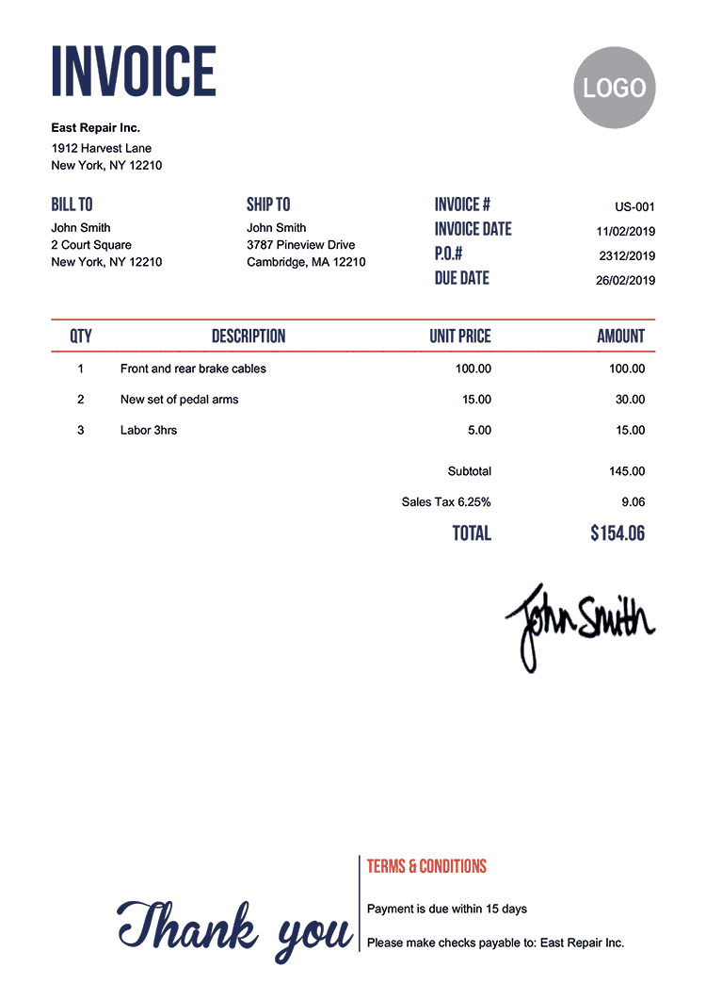

In [33]:

image_path = "/content/invoice2.png"  # <-- change to your file path
display_image(image_path)


In [34]:

resp = call_vision(
    image_path=image_path,
    user_prompt='''Return STRICT JSON {"line_items":[{"description":str,"qty":number|null,"unit_price":number|null,"line_total":number|null}], "notes":[string]}
Prefer numeric values where legible; otherwise null with a note.''',
    json_mode=True
)
print(resp)

{
  "line_items": [
    {
      "description": "Front and rear brake cables",
      "qty": 1,
      "unit_price": 100.00,
      "line_total": 100.00
    },
    {
      "description": "New set of pedal arms",
      "qty": 2,
      "unit_price": 15.00,
      "line_total": 30.00
    },
    {
      "description": "Labor 3hrs",
      "qty": 3,
      "unit_price": 5.00,
      "line_total": 15.00
    }
  ],
  "notes": [
    "Subtotal 145.00",
    "Sales Tax 6.25% 9.06",
    "Total 154.06",
    "Payment is due within 15 days",
    "Please make checks payable to: East Repair Inc."
  ]
}


### 27) Totals verification from image (CoVe)
**Why:** Recompute math from image content.


In [35]:

resp = call_vision(
    image_path=image_path,
    user_prompt='''Recompute subtotal, tax at 10%, total from visible line items. Compare with stated figures.
Return STRICT JSON with computed/stated and issues[], verdict PASS/FAIL.''',
    json_mode=True
)
print(resp)

{
  "computed": {
    "subtotal": 145.00,
    "tax": 14.50,
    "total": 159.50
  },
  "stated": {
    "subtotal": 145.00,
    "tax": 9.06,
    "total": 154.06
  },
  "issues": [
    "Tax rate discrepancy: computed tax at 10% is 14.50 but stated tax is 9.06 (6.25%).",
    "Total does not match computed total with 10% tax."
  ],
  "verdict": "FAIL"
}


### 28) Document type classification (invoice/receipt/PO)
**Why:** Triage routing without separate classifier.


In [36]:

resp = call_vision(
    image_path=image_path,
    user_prompt='''Classify the document as one of ["Invoice","Receipt","Purchase Order","Other"].
Return STRICT JSON {"label":string,"confidence":0-1,"why":"<=20 words"}''',
    json_mode=True
)
print(resp)

{"label":"Invoice","confidence":1,"why":"Document titled 'INVOICE' with billing, shipping, and payment details"}


In [37]:

image_path = "/content/receipt_target.jpg"  # <-- change to your file path
display_image(image_path)


/usr/local/lib/python3.12/dist-packages/PIL/Image.py:3452: DecompressionBombWarning: Image size (100234368 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


In [38]:

resp = call_vision(
    image_path=image_path,
    user_prompt='''Classify the document as one of ["Invoice","Receipt","Purchase Order","Other"].
Return STRICT JSON {"label":string,"confidence":0-1,"why":"<=20 words"}''',
    json_mode=True
)
print(resp)

{"label":"Receipt","confidence":0.99,"why":"Lists purchased item, total paid, and payment method"}


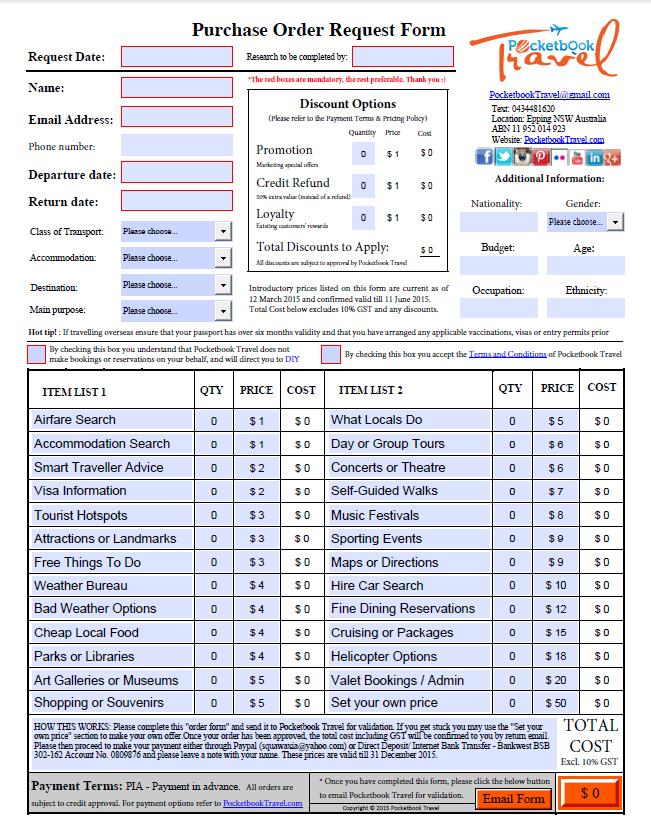

In [39]:

image_path = "/content/purchase_order_form.jpg"  # <-- change to your file path
display_image(image_path)


In [40]:

resp = call_vision(
    image_path=image_path,
    user_prompt='''Classify the document as one of ["Invoice","Receipt","Purchase Order","Other"].
Return STRICT JSON {"label":string,"confidence":0-1,"why":"<=20 words"}''',
    json_mode=True
)
print(resp)

{"label":"Purchase Order","confidence":0.95,"why":"Title and fields indicate order request form for travel services"}


### 29) PII presence scan on a form (image)
**Why:** Flag likely PII fields for redaction.


In [41]:

resp = call_vision(
    image_path=image_path,
    user_prompt='''Identify visible PII types (emails, phone numbers, SSNs). Return STRICT JSON {"pii_types":[string], "example_snippets":[string], "redaction_advice":[string]}''',
    json_mode=True
)
print(resp)

{
  "pii_types": [
    "email",
    "phone number"
  ],
  "example_snippets": [
    "PocketbookTravel@gmail.com",
    "Text: 0434481620"
  ],
  "redaction_advice": [
    "Redact or mask the email address to prevent unauthorized contact, e.g., PocketbookTravel[at]gmail[dot]com.",
    "Redact or mask the phone number to protect privacy, e.g., 0434XXXXXX."
  ]
}


### 30) Contract snippet — parties & dates (image)
**Why:** Extract parties/effective/termination dates.


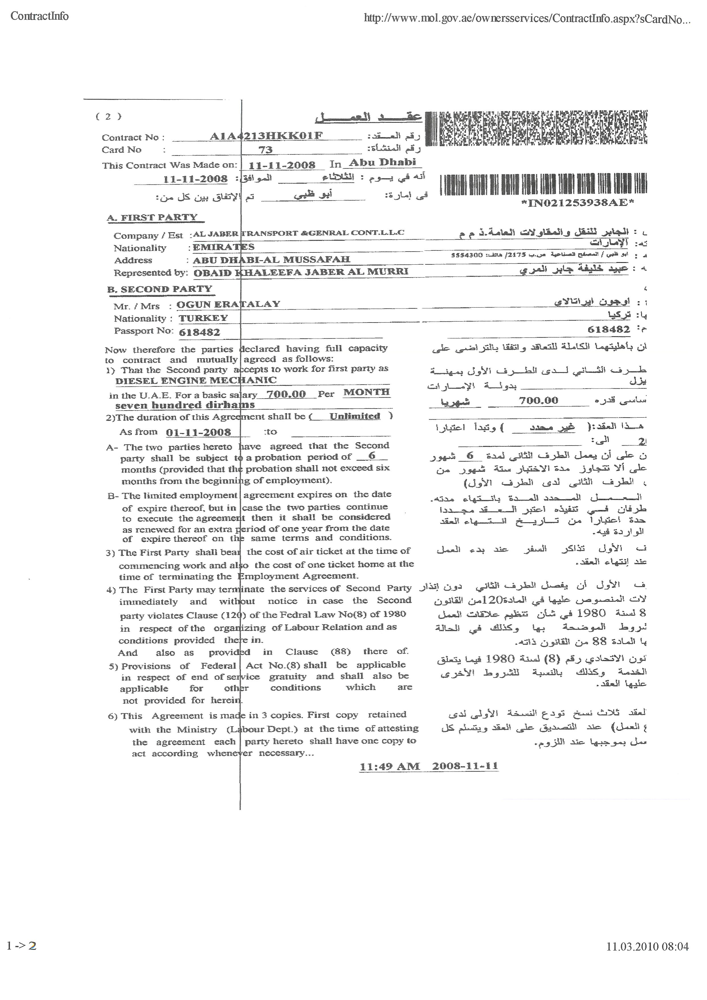

In [42]:
image_path = "/content/contract_worker_page1.jpg"  # <-- change to your file path
display_image(image_path)

In [43]:
resp = call_vision(
    image_path=image_path,
    user_prompt='''Extract STRICT JSON {"parties":[string], "effective_date":str|null, "termination_date":str|null, "missing_fields":[string]}''',
    json_mode=True
)
print(resp)

{
  "parties": [
    "AL JABEER TRANSPORT & GENERAL CONT. L.L.C",
    "OGUN ERATALAY"
  ],
  "effective_date": "11-11-2008",
  "termination_date": null,
  "missing_fields": [
    "termination_date"
  ]
}


### 31) Policy scan → compliance checklist
**Why:** Turn a scanned policy page into a checklist.


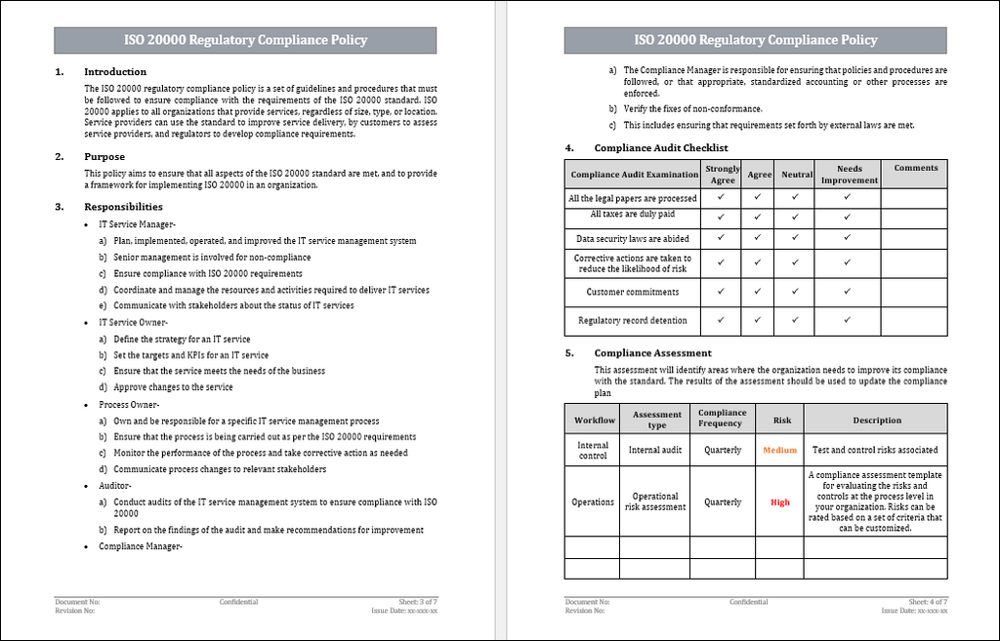

In [45]:
image_path = "policy.png"  # <-- change to your file path

display_image(image_path)

In [46]:

resp = call_vision(
    image_path=image_path,
    user_prompt='''From the policy image, produce a 7-item checklist to validate implementation. Short imperative verbs only.'''
)
print(resp)

1. Process  
2. Monitor  
3. Communicate  
4. Conduct  
5. Report  
6. Verify  
7. Update


### 32) KPI dashboard screenshot summary
**Why:** Summarize chart/dashboard image into concise bullets.


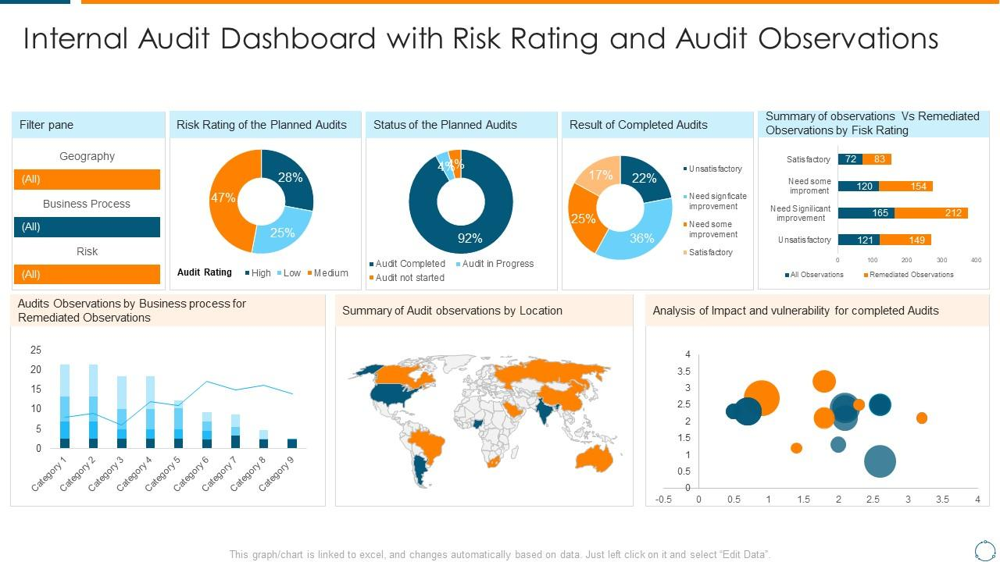

In [47]:
image_path = "/content/dashboard_ceph.jpg"  # <-- change to your file path

display_image(image_path)

In [48]:

resp = call_vision(
    image_path=image_path,
    user_prompt='''Summarize key KPIs and trends in 5 bullets (<= 12 words each). Avoid raw values if illegible.'''
)
print(resp)

- Nearly half of planned audits have medium risk rating.  
- Over 90% of planned audits are completed.  
- Completed audits mostly need some or significant improvement.  
- Remediation rates are lower than total observations across ratings.  
- Audit observations vary widely by business process and location.
